[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/matsuren/neural-ode-cartpole/blob/master/inverted_pendulum_python.ipynb)

# NeuralODE inverted pendulum python version
Python version of the following repogitory
https://github.com/paulxshen/neural-ode-cartpole

Please use GPU runtime if you're running in Colab.

In [ ]:
try:
    import torchdiffeq
except ImportError:
    !pip install -q torchdiffeq

In [1]:
import matplotlib.pyplot as plt
import cv2
import numpy as np
import torch
from torch import nn

from torchdiffeq import odeint

from tqdm.notebook import tqdm
import os
from os.path import join

In [2]:
# Parameter
m = 1  # pole mass kg
M = 2  # cart mass kg
L = 1  # pole length m
g = 9.8  # acceleration constant m/s^2

gpu_id = 0
device = torch.device(f"cuda:{gpu_id}" if torch.cuda.is_available() else "cpu")

# Timespan
fps = 200  # control frame per second
t_end = 1.0
t = torch.linspace(0.0, t_end, int(t_end * fps)).to(device)

# Folder for saving gif
progress_folder = f"vis_gif{gpu_id}"
if not os.path.exists(progress_folder):
    os.mkdir(progress_folder)

In [3]:
from functools import partial

ode_solver = partial(odeint, atol=1e-6, rtol=1e-7, method="dopri5")

## Visualize state

In [4]:
def draw(u):
    """
    Draw inverted pendulum.
    u = [x, dx, theta, dtheta ]
    """
    if isinstance(u, torch.Tensor):
        u = u.detach().cpu()

    # Parameter
    draw_size = (200, 600, 3)  # in pixels
    m2pix = 80  # Convert factor from m to pixel
    box_size = (50, 50)  # in pixels
    box_height = 30  # in pixels
    bkg_color = 240  # Background color

    img = np.full(draw_size, bkg_color, np.uint8)

    # Parse input
    x, dx, theta, dtheta = u

    # Draw box
    pt_ul = (
        int(draw_size[1] / 2 + m2pix * x - box_size[1] / 2),
        int(draw_size[0] - box_size[0] - box_height),
    )
    pt_br = (pt_ul[0] + box_size[0], pt_ul[1] + box_size[1])
    cv2.rectangle(img, pt_ul, pt_br, (0, 255, 0), -1)

    # Draw line
    box_center = 0.5 * (np.array(pt_ul) + np.array(pt_br))
    box_center = box_center.astype(np.int)
    top_position = box_center + m2pix * L * np.array([np.sin(theta), -np.cos(theta)])
    top_position = top_position.astype(np.int)
    cv2.line(img, tuple(box_center), tuple(top_position), (255, 0, 0), 10)

    # Draw coordinates
    cv2.line(img, (0, box_center[1]), (draw_size[1], box_center[1]), (0, 0, 255), 1)
    cv2.line(
        img,
        (draw_size[1] // 2, box_center[1] + 25),
        (draw_size[1] // 2, box_center[1] - 25),
        (0, 0, 255),
        1,
    )
    return img

In [5]:
from PIL import Image
from typing import List
import IPython


def save_gif(vis_hist: List[np.ndarray], fname="tmp.gif", fps=10):
    gif_imgs = [Image.fromarray(it) for it in vis_hist]
    gif_imgs[0].save(
        fname,
        save_all=True,
        append_images=gif_imgs[1:],
        optimize=False,
        fps=fps,
        loop=0,
    )

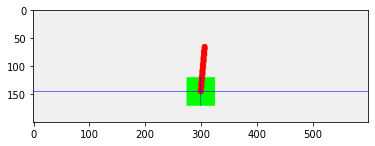

In [6]:
u = torch.tensor([0.0, 0.0, 0.1, 0.0], device=device)
plt.imshow(draw(u))

## Build model

In [7]:
class ODEFunc(nn.Module):
    def __init__(self, hdim=8, with_control=True):
        super(ODEFunc, self).__init__()

        # Be able to simulate without control for debug
        self.with_control = with_control

        # Control network
        input_dim = 3
        self.control = nn.Sequential(
            nn.Linear(input_dim, hdim),
            nn.Tanh(),
            #             nn.Linear(hdim, hdim), nn.Tanh(),
            nn.Linear(hdim, 1),
        )

    def forward(self, t, u):
        # Extract input
        x, dx, theta, dtheta = u[..., 0], u[..., 1], u[..., 2], u[..., 3]

        # Control force
        if self.with_control:
            control_input = torch.stack([torch.cos(theta), torch.sin(theta), dtheta])
            f = self.control(control_input)
        else:
            f = 0.0

        # Dynamics equations
        du = torch.zeros_like(u)
        du[..., 0] = dx
        du[..., 1] = (
            f - m * (g * torch.cos(theta) - L * dtheta ** 2) * torch.sin(theta)
        ) / (M + m * torch.sin(theta) ** 2)
        du[..., 2] = dtheta
        du[..., 3] = (
            M * g * torch.sin(theta)
            + g * m * torch.sin(theta)
            - (f + L * m * torch.sin(theta) * dtheta ** 2) * torch.cos(theta)
        ) / (L * (M + m * torch.sin(theta) ** 2))
        return du

## Check model without controller

In [8]:
# Model
model = ODEFunc(with_control=False).to(device)

# Initial state
u = torch.tensor([0.0, 0.0, 0.4, 0.0], device=device)

# Solve ODE
with torch.no_grad():
    u_hist = ode_solver(model, u, t)

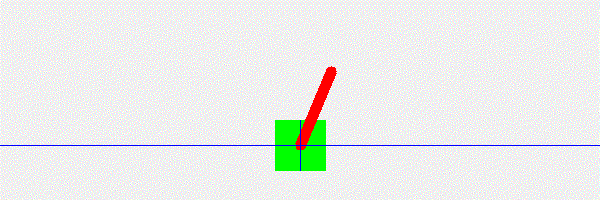

In [9]:
# Animation
vis_hist = []
for u in u_hist:
    vis_hist.append(draw(u))

# Save as gif and visualize
gif_fname = "tmp.gif"
save_gif(vis_hist, gif_fname)
IPython.display.Image(gif_fname, format="png")

In [10]:
# from IPython.display import HTML
# HTML('<img src="./tmp.gif">')

## Train controller

In [11]:
#
def modpi(theta):
    theta_modpi = theta.clone()
    theta_modpi[theta > np.pi] = 2 * np.pi - theta[theta > np.pi]
    return theta_modpi


# Mean square error
def mse(x):
    return torch.mean(x ** 2)


# Loss function
def loss_func(u_hist):
    x, dx, theta, dtheta = (
        u_hist[..., 0],
        u_hist[..., 1],
        u_hist[..., 2],
        u_hist[..., 3],
    )

    # theta should be 0 <= theta <= pi
    theta = modpi(theta)
    #
    loss = mse(theta) + 4 * mse(theta[-1]) + mse(dx[-1])
    #     loss = mse(theta) + 4 * mse(theta[-1]) + mse(dx[-1]) + mse(dtheta[-1])
    #     loss = mse(theta) + 4 * mse(theta[-10:]) + mse(dx[-10:])
    return loss


Finish training


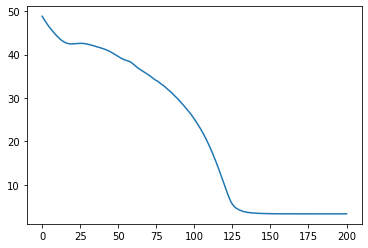

In [12]:
# Model
model = ODEFunc(with_control=True).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.05)

# Initial state
init_u = torch.tensor([0.0, 0.0, np.pi, 0.0], device=device)

# Start training
total_epoch = 201
loss_hist = []
model.train()
pbar = tqdm(range(total_epoch))
pbar.set_description("[Train]")
for epoch in pbar:
    # Solve ODE
    u_hist = ode_solver(model, init_u, t)

    # Calculate loss and update weight
    optimizer.zero_grad()
    loss = loss_func(u_hist)
    loss.backward()
    optimizer.step()

    # Display
    pbar.set_postfix({"loss": loss.item()})
    loss_hist.append(loss.item())

    if not epoch % 20:
        # Save current animation
        vis_hist = []
        for u in u_hist:
            vis_hist.append(draw(u))

        # Save as gif and visualize
        gif_fname = join(progress_folder, f"train_pend_{epoch}.gif")
        save_gif(vis_hist, gif_fname)
        torch.save(
            {"state_dict": model.state_dict()},
            join(progress_folder, f"checkpoints_{epoch}.pt"),
        )
print("Finish training")
plt.plot(loss_hist)

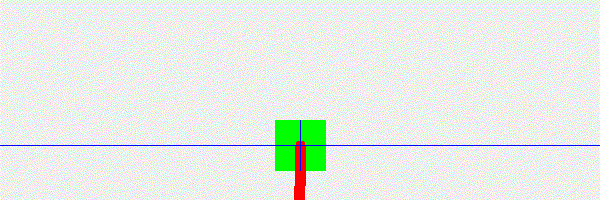

In [13]:
IPython.display.Image(gif_fname, format="png")